Visualizing Global Refugee Crisis Using Pythonic ETL


In [42]:
import csv
# import json
# from pprint import pprint #alphabetize keys and output a legible dictionary from json 

import pandas as pd 
from matplotlib import pyplot as plt 
import numpy as np 
# from numpy import loadtxt #read csv 

from geopy.geocoders import Nominatim #openstreetmap API library 
from geopy.exc import GeocoderTimedOut #manipulate timeout when geocoding compiles

from collections import defaultdict
from collections import namedtuple

from mpl_toolkits.basemap import Basemap
# from mpl_toolkits.mplot3d import Axes3D
# from matplotlib.collections import PolyCollection

from datetime import datetime
import operator 

##################################################
# Initial Data Extraction/Transformation/Loading (ETL)
##################################################

filename = r'/Users/yenkha/gitworkdirectory/dev/notebooks/unhcr_time_series_population.csv'

def convert(str):
  '''
  Converts missing value from string to int 
  to handle error exceptions.
  '''
  try: 
    return int(str)
  except ValueError: 
    return 0

#Generate a master list to store the dataset
by_year = []

with open(filename) as file: 
  reader = csv.reader(file)
  header_row = next(reader) #returns next line in the file
# print(header_row) #['Year', 'Country / territory of asylum/residence', 'Origin', 'Population type', 'Value']

  for row in reader: 
   # by_year.append(row)
   # print(row)
    year = convert(row[0])
    country = row[1]
    origin = row[2]
    poptype = row[3]
    popvalue = convert(row[4])
    
    # new_row = [] 
    # new_row.extend((year, country, origin, poptype, popvalue)) #create new row
    
    #create a list of dictionary to reassign variable names 
    new_row = dict({'Year':year,'Country':country,'Origin':origin,'Population Type':poptype,'Population Count':popvalue})

    by_year.append(new_row) #store new list of all new rows 
print(by_year)

[{'Year': 1951, 'Country': 'Australia', 'Origin': 'Various/Unknown', 'Population Type': 'Refugees (incl. refugee-like situations)', 'Population Count': 180000}, {'Year': 1951, 'Country': 'Austria', 'Origin': 'Various/Unknown', 'Population Type': 'Refugees (incl. refugee-like situations)', 'Population Count': 282000}, {'Year': 1951, 'Country': 'Belgium', 'Origin': 'Various/Unknown', 'Population Type': 'Refugees (incl. refugee-like situations)', 'Population Count': 55000}, {'Year': 1951, 'Country': 'Canada', 'Origin': 'Various/Unknown', 'Population Type': 'Refugees (incl. refugee-like situations)', 'Population Count': 168511}, {'Year': 1951, 'Country': 'Switzerland', 'Origin': 'Various/Unknown', 'Population Type': 'Refugees (incl. refugee-like situations)', 'Population Count': 10000}, {'Year': 1951, 'Country': 'Germany', 'Origin': 'Various/Unknown', 'Population Type': 'Refugees (incl. refugee-like situations)', 'Population Count': 265000}, {'Year': 1951, 'Country': 'Denmark', 'Origin': '

In [46]:
################
#Exploring data uniqueness in Pandas coupled with built-in data structures 
################

#Using Pandas apply() method to identify unique population type  
df = pd.read_csv(r'Desktop/unhcr_time_series_population.csv', header=None, low_memory=False)
print(list(df.apply(set)[3])) #Population Type is at index[3]

['Refugees (incl. refugee-like situations)', 'Returnees', 'Returned IDPs', 'Others of concern', 'Asylum-seekers', 'Population type', 'Stateless', 'Internally displaced persons']


In [3]:
#Alternatively, use dictionary iterator coupled with Pandas to loop through 
#each of the unique values based on its corresponding keys. 
for i, item in df.iteritems(): 
    print(item.unique())

['Year' '1951' '1952' '1953' '1954' '1955' '1956' '1957' '1958' '1959'
 '1960' '1961' '1962' '1963' '1964' '1965' '1966' '1967' '1968' '1969'
 '1970' '1971' '1972' '1973' '1974' '1975' '1976' '1977' '1978' '1979'
 '1980' '1981' '1982' '1983' '1984' '1985' '1986' '1987' '1988' '1989'
 '1990' '1991' '1992' '1993' '1994' '1995' '1996' '1997' '1998' '1999'
 '2000' '2001' '2002' '2003' '2004' '2005' '2006' '2007' '2008' '2009'
 '2010' '2011' '2012' '2013' '2014' '2015' '2016']
['Country / territory of asylum/residence' 'Australia' 'Austria' 'Belgium'
 'Canada' 'Switzerland' 'Germany' 'Denmark' 'Spain' 'France'
 'United Kingdom' 'Greece' 'China, Hong Kong SAR' 'Italy' 'Luxembourg'
 'Morocco' 'Netherlands' 'Norway' 'Sweden' 'Tunisia' 'Turkey'
 'United States of America' 'Dem. Rep. of the Congo' 'Burundi' 'Togo'
 'United Rep. of Tanzania' 'Uganda' 'Iran (Islamic Rep. of)' 'Senegal'
 'Central African Rep.' 'Egypt' 'India' 'Cambodia' 'Lebanon'
 'China, Macao SAR' 'Nepal' 'Rwanda'
 'Serbia and Ko

In [4]:
##################################
#Compute Year and Total Population
##################################

#########
#ETL: Dictionary - Dataset for all years from 1952-2016
#########
def popsum_allyears(by_year):
  dict_allyears = {}

  for row in by_year: 
      year = row['Year']
      count = row['Population Count']

      # if year >= 2007: 
        # print(year)
      if year in dict_allyears : #if 'year' as the key in dict
        dict_allyears [year]+= count
        # print(dict_year)
      else: 
        dict_allyears [year] = count #initializing the count 
        # print(dict_year)
  return dict_allyears 
print(popsum_allyears(by_year))

{1951: 1957211, 1952: 1787928, 1953: 1679304, 1954: 1581628, 1955: 1547066, 1956: 1600875, 1957: 1582814, 1958: 1545310, 1959: 1520185, 1960: 1504664, 1961: 1641867, 1962: 1623322, 1963: 1556603, 1964: 2954919, 1965: 3307715, 1966: 3392873, 1967: 2184521, 1968: 2335566, 1969: 2465347, 1970: 2457470, 1971: 2475530, 1972: 2641290, 1973: 2443425, 1974: 2484113, 1975: 2864274, 1976: 3680521, 1977: 4397079, 1978: 5175894, 1979: 6681492, 1980: 8992497, 1981: 9846068, 1982: 10534129, 1983: 10541228, 1984: 10915310, 1985: 12017118, 1986: 12352194, 1987: 12901217, 1988: 14563933, 1989: 14863735, 1990: 17528927, 1991: 19032641, 1992: 19903052, 1993: 21175056, 1994: 24083049, 1995: 20235263, 1996: 20255583, 1997: 18993312, 1998: 19140488, 1999: 19783872, 2000: 21862477, 2001: 19891636, 2002: 20878662, 2003: 17007438, 2004: 19516531, 2005: 21049801, 2006: 32839394, 2007: 31676571, 2008: 34446982, 2009: 36462155, 2010: 33897991, 2011: 35440916, 2012: 35847172, 2013: 42864462, 2014: 54958844, 2015: 

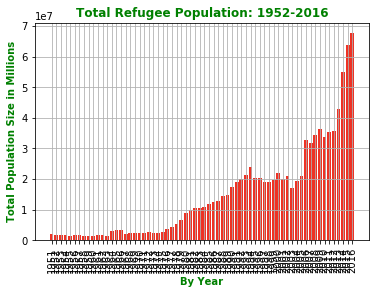

In [5]:
############
#PLOTTING: bar chart for total population across all years: 1952-2016
###########
dict_allyears = popsum_allyears(by_year)

plt.bar(range(len(dict_allyears)), dict_allyears.values(), align="center", color='#EE3224')
plt.xticks(range(len(dict_allyears)), list(dict_allyears.keys()), rotation=90)

plt.title('Total Refugee Population: 1952-2016',fontweight='bold', color='g', fontsize='12')
plt.xlabel('By Year', fontweight='bold', color='g', fontsize='10')
plt.ylabel('Total Population Size in Millions',fontweight='bold', color='g', fontsize='10')
plt.grid(True)

plt.show()

#saving plot 
# plt.savefig('popsum_byallyear.png')

In [23]:
############
#ETL: Dictionary - total population by year beginning 2007-2016 
#############
def popsum(by_year):
  dict_year = {}

  for row in by_year: 
      year = row['Year']
      count = row['Population Count']

      if year >= 2007: 
        # print(year)
        if year in dict_year: #if 'year' as the key in dict
          dict_year[year]+= count
          # print(dict_year)
        else: 
          dict_year[year] = count #initializing the count 
        # print(dict_year)
  return dict_year
print(popsum(by_year))

{2007: 31676571, 2008: 34446982, 2009: 36462155, 2010: 33897991, 2011: 35440916, 2012: 35847172, 2013: 42864462, 2014: 54958844, 2015: 63907656, 2016: 67635713}


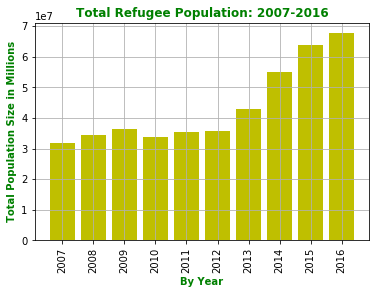

In [30]:
##################
#PLOTTING: bar chart - total refugee population for 2007-2016
###################

#creating a bar graph from matplotlib by year and total population
dict_year = popsum(by_year) #call a popsum function 

plt.bar(range(len(dict_year)), dict_year.values(), align="center", color='y')
plt.xticks(range(len(dict_year)), list(dict_year.keys()), rotation=90)
plt.grid(True)

plt.title('Total Refugee Population: 2007-2016',fontweight='bold', color='g', fontsize='12')
plt.xlabel('By Year', fontweight='bold', color='g', fontsize='10')
plt.ylabel('Total Population Size in Millions',fontweight='bold', color='g', fontsize='10')

plt.show()

#saving plot 
# plt.savefig('popsum_byallyear.png')

In [51]:
#####################################################################################
#                           COUNTRY ANALYSIS 
####################################################################################

#############
#ETL: Dictionary - Extract aggregated data based on total refugee population by year and country 
#############

def yearcountry(by_year):
  dict_country_count = {}

  for row in by_year: 
    year = row['Year']
    count = row['Population Count']
    country = row['Country']
#     origin = row['Origin']

    if year >= 2007: 
        if country in dict_country_count: 
          dict_country_count[country]+= count 
        else: 
          dict_country_count[country] = count 
  return dict_country_count
print(yearcountry(by_year))

{'Afghanistan': 10715042, 'Angola': 327771, 'Albania': 40006, 'United Arab Emirates': 11590, 'Argentina': 46358, 'Armenia': 345230, 'Antigua and Barbuda': 20, 'Australia': 403103, 'Austria': 928329, 'Azerbaijan': 6179118, 'Burundi': 1303920, 'Belgium': 446962, 'Benin': 48485, 'Burkina Faso': 191316, 'Bangladesh': 1946032, 'Bulgaria': 122957, 'Bahrain': 2656, 'Bosnia and Herzegovina': 1676327, 'Belarus': 85294, 'Belize': 6454, 'Bolivia (Plurinational State of)': 7545, 'Brazil': 230029, 'Botswana': 31533, 'Central African Rep.': 4056812, 'Canada': 1918049, 'Switzerland': 763749, 'Chile': 24737, 'China': 3029230, "Côte d'Ivoire": 7417852, 'Cameroon': 2041908, 'Dem. Rep. of the Congo': 28081195, 'Congo': 967588, 'Colombia': 46573581, 'Costa Rica': 179013, 'Cuba': 4144, 'Cyprus': 99015, 'Czech Rep.': 44668, 'Germany': 6751654, 'Djibouti': 188146, 'Denmark': 272387, 'Algeria': 971169, 'Ecuador': 1578481, 'Egypt': 1724083, 'Eritrea': 41444, 'Spain': 113049, 'Estonia': 972709, 'Ethiopia': 3792

In [50]:
#Generate a list of countries for mapping
dict_country_count = yearcountry(by_year)

def get_country_list(dict_country_count): 
  
  year_country_list = [] 

  for country_key in sorted(dict_country_count): 
    year_country_list.append(country_key)
  return year_country_list
print(get_country_list(dict_country_count))

['Afghanistan', 'Albania', 'Algeria', 'Angola', 'Anguilla', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bolivia (Plurinational State of)', 'Bonaire', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'British Virgin Islands', 'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Burundi', 'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada', 'Cayman Islands', 'Central African Rep.', 'Chad', 'Chile', 'China', 'China, Hong Kong SAR', 'China, Macao SAR', 'Colombia', 'Congo', 'Costa Rica', 'Croatia', 'Cuba', 'Curaçao', 'Cyprus', 'Czech Rep.', "Côte d'Ivoire", "Dem. People's Rep. of Korea", 'Dem. Rep. of the Congo', 'Denmark', 'Djibouti', 'Dominican Rep.', 'Ecuador', 'Egypt', 'El Salvador', 'Eritrea', 'Estonia', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Gu

In [9]:
#Gecodoing countries to get latitudes and longitudes
year_country_list = get_country_list(dict_country_count)

#defining a class using a factory function - mamedtuple 
latslons = namedtuple('latslons',['lat', 'lon']) 

def geos_country(year_country_list): 

    #initializing nomatim server with a higher timeout 
    geolocator=Nominatim(timeout=10)
    #create a new list to hold the namedtuples
    geo_country_dict = {}

    for country_key in year_country_list:
    # for origin_key in sorted(dict_origin_count):
        location = geolocator.geocode(country_key)
        #if there is a location, output lats and lons into geos
        if location: 
            #instantiating class - latslons 
          geos = latslons(location.latitude, location.longitude)   
             #retrieving country as dict key and geos for values       
          geo_country_dict[country_key] = geos 
    return geo_country_dict 
# print(geos_country(year_country_list))

{'Afghanistan': latslons(lat=33.7680065, lon=66.2385139), 'Albania': latslons(lat=11.24488255, lon=-72.5160988093715), 'Algeria': latslons(lat=28.0000272, lon=2.9999825), 'Angola': latslons(lat=-11.8775768, lon=17.5691241), 'Anguilla': latslons(lat=18.1954947, lon=-63.0750234), 'Antigua and Barbuda': latslons(lat=17.079128, lon=-61.8222516), 'Argentina': latslons(lat=-34.9964963, lon=-64.9672817), 'Armenia': latslons(lat=4.4922673, lon=-75.7396253904384), 'Aruba': latslons(lat=12.5013629, lon=-69.9618475), 'Australia': latslons(lat=-24.7761086, lon=134.755), 'Austria': latslons(lat=47.2000338, lon=13.199959), 'Azerbaijan': latslons(lat=40.3936294, lon=47.7872508), 'Bahamas': latslons(lat=24.7736546, lon=-78.0000547), 'Bahrain': latslons(lat=35.2078012, lon=72.5473968), 'Bangladesh': latslons(lat=24.4768783, lon=90.2932426), 'Barbados': latslons(lat=13.1500331, lon=-59.5250305), 'Belarus': latslons(lat=53.4250605, lon=27.6971358), 'Belgium': latslons(lat=50.6407351, lon=4.66696), 'Beliz

In [ ]:
#Writing geocode to CSV
geo_country_dict = geos_country(year_country_list)

# output to CSV files for further analysis to prevent exceeding API calls
with open('countrylatslons.csv','w') as outfile: 
  fieldnames = ['country','lats','lons'] 
  write = csv.DictWriter(outfile, fieldnames=fieldnames)
  for key, value in geo_country_dict.items(): 
    write.writerow({'country': key, 'lats': value[0],'lons': value[1]}) 

In [58]:
#Reading CSV and writing into a dictionary for mapping
file = r'/Users/yenkha/gitworkdirectory/dev/countrylatslons.csv'

country_latslons_dict = {}

with open(file, 'r') as infile: 
  read = csv.reader(infile)
# print(read)
  for row in read:
    country,lat,lon = row 
    country_latslons_dict[country] = latslons(float(lat),float(lon)) #namedtuple 
print(country_latslons_dict)

{'Afghanistan': latslons(lat=33.7680065, lon=66.2385139), 'Albania': latslons(lat=11.24488255, lon=-72.5160988093715), 'Algeria': latslons(lat=28.0000272, lon=2.9999825), 'Angola': latslons(lat=-11.8775768, lon=17.5691241), 'Anguilla': latslons(lat=18.1954947, lon=-63.0750234), 'Antigua and Barbuda': latslons(lat=17.079128, lon=-61.8222516), 'Argentina': latslons(lat=-34.9964963, lon=-64.9672817), 'Armenia': latslons(lat=4.4922673, lon=-75.7396253904384), 'Aruba': latslons(lat=12.5013629, lon=-69.9618475), 'Australia': latslons(lat=-24.7761086, lon=134.755), 'Austria': latslons(lat=47.2000338, lon=13.199959), 'Azerbaijan': latslons(lat=40.3936294, lon=47.7872508), 'Bahamas': latslons(lat=24.7736546, lon=-78.0000547), 'Bahrain': latslons(lat=35.2078012, lon=72.5473968), 'Bangladesh': latslons(lat=24.4768783, lon=90.2932426), 'Barbados': latslons(lat=13.1500331, lon=-59.5250305), 'Belarus': latslons(lat=53.4250605, lon=27.6971358), 'Belgium': latslons(lat=50.6407351, lon=4.66696), 'Beliz

In [59]:
################
#ANALYSIS: Get top 10 countries with highest refugee population from CSV
################
dict_country_count = yearcountry(by_year)

def top_10_country_year(dict_country_count):
  return sorted(dict_country_count, key=dict_country_count.get, reverse=True)[:10] 
    # return sorted(dict_country_count.items(), key = operator.itemgetter(1) , reverse = True)[:10]
print(top_10_country_year(dict_country_count)) #list of 10 countries 

['Colombia', 'Syrian Arab Rep.', 'Pakistan', 'Iraq', 'Dem. Rep. of the Congo', 'Sudan', 'Somalia', 'Thailand', 'Myanmar', 'Afghanistan']


In [60]:
#Generate final dataset by calling two parameters to get 
#the top 10 countries with lats and lons by 
#creating a new list from top 10 country function.

year_country_list = top_10_country_year(dict_country_count)

def top_10_country_map(year_country_list, country_latslons_dict):

  top_10_country_latslons = []
  for country in year_country_list: 
    if country in country_latslons_dict: 
      top_10_country_latslons.append(country_latslons_dict[country])
  return top_10_country_latslons
print(top_10_country_map(year_country_list, country_latslons_dict))

[latslons(lat=2.8894434, lon=-73.783892), latslons(lat=34.8021, lon=38.9968), latslons(lat=30.3308401, lon=71.247499), latslons(lat=33.0955793, lon=44.1749775), latslons(lat=4.0383, lon=21.7587), latslons(lat=14.5844444, lon=29.4917691), latslons(lat=-13.180556, lon=15.266667), latslons(lat=14.8971921, lon=100.83273), latslons(lat=21.9162, lon=95.956), latslons(lat=33.7680065, lon=66.2385139)]


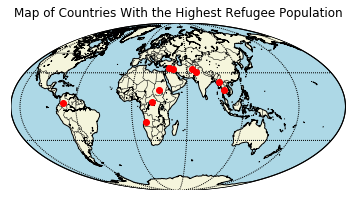

In [72]:
########################
#PROJECTION MAPPING: Countries of asylum-seeking population 
########################

#Loop through lats/lons csv to genereate (x,y) lists for reading.
top_10_country_latslons = top_10_country_map(year_country_list, country_latslons_dict)

lats,lons = [],[]

for row in top_10_country_latslons: 
  # print(row)
  lats.append(row[0])
  lons.append(row[1])
# print(lats,lons)

#mapping lats/lons 
country_map = Basemap(projection='moll', resolution = 'c', area_thresh=500.0,
    lat_0=0, lon_0=50)

#drawing coastlines and country boundaries on the map
country_map.drawcoastlines()
country_map.drawcountries()
country_map.fillcontinents(color='beige', lake_color='lightblue')
country_map.drawmapboundary(fill_color='lightblue')

#defining lats and lons lines: begin, end, apart from np.arrange() 
country_map.drawmeridians(np.arange(0, 420, 60))
country_map.drawparallels(np.arange(-90, 120, 60))

#countries of asylum
x,y = country_map(lons,lats)
country_map.plot(x, y, 'ro', color='r', markersize=6)

plt.title('Map of Countries With the Highest Refugee Population') 

plt.show()

#saving plot 
# plt.savefig('country_map.png')

In [9]:
###################################################################
#                      REFUGEE ANALYSIS 
####################################################################

###################
#ETL: Nested Dictionary - Get population type and count by year
####################

def poptypecount_byyear2(by_year):
  dict_poptype_year = {} #master dictionary 
  for row in by_year: 
      year = row['Year']
      count = row['Population Count']
      poptype = row['Population Type']
      # print year, status, count

      if year >= 2007: 
               
        if year in dict_poptype_year:
          poptype_dict = dict_poptype_year[year]
        else:
          poptype_dict = {} #inner dictionary 
          dict_poptype_year[year] = poptype_dict
        if poptype in poptype_dict: 
          poptype_dict[poptype] += count 
        else: 
          poptype_dict[poptype] = count 
    # print (dict_status_year)
  return dict_poptype_year 
print(poptypecount_byyear2(by_year))

{2007: {'Internally displaced persons': 13740317, 'Returned IDPs': 2070118, 'Asylum-seekers': 741110, 'Refugees (incl. refugee-like situations)': 11390930, 'Returnees': 728166, 'Stateless': 2937315, 'Others of concern': 68615}, 2008: {'Internally displaced persons': 14442227, 'Returned IDPs': 1361436, 'Asylum-seekers': 825043, 'Refugees (incl. refugee-like situations)': 10489812, 'Returnees': 589441, 'Stateless': 6572167, 'Others of concern': 166856}, 2009: {'Internally displaced persons': 15628057, 'Returned IDPs': 2229540, 'Asylum-seekers': 989169, 'Refugees (incl. refugee-like situations)': 10396538, 'Returnees': 247580, 'Others of concern': 411698, 'Stateless': 6559573}, 2010: {'Asylum-seekers': 837445, 'Internally displaced persons': 14697804, 'Others of concern': 1255579, 'Returned IDPs': 2923233, 'Refugees (incl. refugee-like situations)': 10549681, 'Stateless': 3463070, 'Returnees': 171179}, 2011: {'Asylum-seekers': 897021, 'Internally displaced persons': 15473378, 'Others of c

In [18]:
#################
#Alternative ETL Defaultdict() Function: nested dictionary: Extract data for total Population types and 
#count across 10 year period 2007-2016
#############

def statuscount_byyear(by_year):
  
  dict_status_year = defaultdict(lambda : defaultdict(int)) #default value of int is 0

  for row in by_year: 
      year = row['Year']
      count = row['Population Count']
      status = row['Population Type']

      if year >= 2007:
       # print year, status, count
          dict_status_year[year][status] += count
    # print(dict_status_year)
  return dict_status_year
print(statuscount_byyear(by_year))

defaultdict(<function statuscount_byyear.<locals>.<lambda> at 0x11c2a76a8>, {2007: defaultdict(<class 'int'>, {'Internally displaced persons': 13740317, 'Returned IDPs': 2070118, 'Asylum-seekers': 741110, 'Refugees (incl. refugee-like situations)': 11390930, 'Returnees': 728166, 'Stateless': 2937315, 'Others of concern': 68615}), 2008: defaultdict(<class 'int'>, {'Internally displaced persons': 14442227, 'Returned IDPs': 1361436, 'Asylum-seekers': 825043, 'Refugees (incl. refugee-like situations)': 10489812, 'Returnees': 589441, 'Stateless': 6572167, 'Others of concern': 166856}), 2009: defaultdict(<class 'int'>, {'Internally displaced persons': 15628057, 'Returned IDPs': 2229540, 'Asylum-seekers': 989169, 'Refugees (incl. refugee-like situations)': 10396538, 'Returnees': 247580, 'Others of concern': 411698, 'Stateless': 6559573}), 2010: defaultdict(<class 'int'>, {'Asylum-seekers': 837445, 'Internally displaced persons': 14697804, 'Others of concern': 1255579, 'Returned IDPs': 2923233

In [63]:
#######################
#ETL: Dictionary - Extract data for total Population types and 
#count across 10 year period 2007-2016
######################

def populationtype_count(by_year):
  dict_poptype_count = {}

  for row in by_year: 
    year = row['Year']
    count = row['Population Count']
    poptype = row['Population Type']
#     origin = row['Origin']

    if year >= 2007: 
        if poptype in dict_poptype_count: 
          dict_poptype_count[poptype] += count 
        else: 
          dict_poptype_count[poptype] = count 
  return dict_poptype_count 
print(populationtype_count(by_year))

{'Internally displaced persons': 221973624, 'Returned IDPs': 25382848, 'Asylum-seekers': 14143043, 'Refugees (incl. refugee-like situations)': 123109127, 'Returnees': 4086497, 'Stateless': 40236504, 'Others of concern': 8206819}


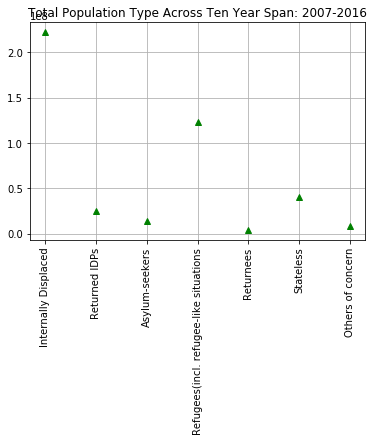

In [16]:
#############################
#PLOTTING: Generate a scatter plot to represent 
#total refugee population across 10 year span: 2007 - 2016
############################

dict_poptype_count = populationtype_count(by_year)

#creating lists to generate a scatter plot from a dictionary
poptype_data = list(dict_poptype_count.values())
pop_types = list(dict_poptype_count.keys())

#initializing axes instance
fix, ax = plt.subplots()
plt.plot(poptype_data, 'g^', linewidth=3, color='g') #creates a scatter plot

# plt.plot(poptype_data,'r--', color='r') #creates a line plot 

#retrieving text labels for plotting 
labels = ['Internally Displaced','Returned IDPs','Asylum-seekers','Refugees(incl. refugee-like situations','Returnees','Stateless','Others of concern']

x1 = [0,1,2,3,4,5,6]
ax.set_xticks(x1)
ax.set_xticklabels(labels, rotation='vertical')

# plt.ylabel('Population Type in Millions')
plt.title('Total Population Type Across Ten Year Span: 2007-2016')
plt.grid(True)

plt.show()
# plt.savefig('total_poptypes_count.png')

In [19]:
################################
#ETL for Population Types: Dictionary - Get country 
#and origins by two highest population types for the last 3 years: 2014 - 2016 
#################################

#Getting origins based on refugee population types
def poptypes_origin_count(by_year):
  dict_poptype_count = {}

  for row in by_year: 
    year = row['Year']
    count = row['Population Count']
    poptype = row['Population Type']
    origin = row['Origin']

    if year >= 2014 and (poptype == 'Refugees(incl. refugee-like situations)' or poptype == 'Asylum-seekers'): 
        if origin in dict_poptype_count :
        # if origin in dict_poptype_count and (origin != 'Various/Unknown'): 
          dict_poptype_count[origin]+= count 
        else: 
          dict_poptype_count[origin] = count 
  return dict_poptype_count
print(poptypes_origin_count(by_year))

{'Colombia': 24176, 'Cuba': 9202, 'Afghanistan': 720208, 'Iran (Islamic Rep. of)': 180367, 'Iraq': 620370, 'Kazakhstan': 5034, 'Kyrgyzstan': 6538, 'Pakistan': 176813, 'Palestinian': 13944, 'Tajikistan': 5597, 'Uzbekistan': 7744, 'Burundi': 70605, 'Central African Rep.': 35611, "Côte d'Ivoire": 45833, 'Cameroon': 23397, 'Dem. Rep. of the Congo': 225995, 'Congo': 11851, 'Djibouti': 1804, 'Algeria': 20285, 'Eritrea': 180106, 'Western Sahara': 4619, 'Ethiopia': 216172, 'Guinea': 60156, 'Gambia': 42334, 'Guinea-Bissau': 5601, 'Haiti': 38441, 'Liberia': 7397, 'Libya': 16506, 'Mali': 31815, 'Mauritania': 21865, 'Mauritius': 572, 'Nigeria': 148927, "Dem. People's Rep. of Korea": 992, 'Rwanda': 32652, 'Sudan': 125942, 'Senegal': 39389, 'Sierra Leone': 11353, 'Somalia': 167698, 'Syrian Arab Rep.': 514567, 'Chad': 9744, 'Togo': 6472, 'United Rep. of Tanzania': 3877, 'Uganda': 16535, 'South Africa': 2323, 'Zambia': 1033, 'Zimbabwe': 143000, 'Armenia': 28522, 'Azerbaijan': 17889, 'China': 177588, '

In [20]:
#Retrieving the top 10 origins with highest population types 
dict_poptype_count = poptypes_origin_count(by_year)

def top_10_origin_poptype(dict_poptype_count):
    return sorted(dict_poptype_count, key=dict_poptype_count.get, reverse=True)[:11] #additional country added due to "various/unknowns" origin type 
    # return sorted(dict_poptype_count.items(), key = operator.itemgetter(1) , reverse = True)[:10] #gives country/count
print(top_10_origin_poptype(dict_poptype_count))


['Various/Unknown', 'Afghanistan', 'Iraq', 'Syrian Arab Rep.', 'Dem. Rep. of the Congo', 'Ethiopia', 'Iran (Islamic Rep. of)', 'Eritrea', 'China', 'Pakistan', 'Myanmar']


In [21]:
#Getting countries based on refugee population types
def poptypes_country_count(by_year):
  dict_poptype_country_count = {}

  for row in by_year: 
    year = row['Year']
    count = row['Population Count']
    country = row['Country']
    poptype = row['Population Type']

    if year >= 2014 and (poptype == 'Refugees(incl. refugee-like situations)' or poptype == 'Asylum-seekers'): 
        if country in dict_poptype_country_count: 
          dict_poptype_country_count[country]+= count 
        else: 
          dict_poptype_country_count[country] = count 
  return dict_poptype_country_count
print(poptypes_country_count(by_year))

{'Aruba': 5, 'Afghanistan': 267, 'Angola': 90486, 'Albania': 4065, 'United Arab Emirates': 1237, 'Argentina': 5837, 'Armenia': 205, 'Antigua and Barbuda': 0, 'Australia': 71662, 'Austria': 187337, 'Azerbaijan': 835, 'Burundi': 9585, 'Belgium': 70019, 'Benin': 465, 'Burkina Faso': 462, 'Bangladesh': 13, 'Bulgaria': 32240, 'Bahrain': 256, 'Bahamas': 50, 'Bosnia and Herzegovina': 79, 'Belarus': 747, 'Belize': 3261, 'Bolivia (Plurinational State of)': 16, 'Brazil': 67387, 'Barbados': 0, 'Brunei Darussalam': 0, 'Botswana': 415, 'Central African Rep.': 1033, 'Canada': 60209, 'Switzerland': 84276, 'Chile': 4820, 'China': 1790, "Côte d'Ivoire": 1569, 'Cameroon': 20348, 'Dem. Rep. of the Congo': 3476, 'Congo': 14208, 'Colombia': 648, 'Cabo Verde': 0, 'Costa Rica': 8653, 'Cuba': 54, 'Curaçao': 127, 'Cayman Islands': 30, 'Cyprus': 7757, 'Czech Rep.': 1873, 'Germany': 1234099, 'Djibouti': 14521, 'Denmark': 13527, 'Dominican Rep.': 2291, 'Algeria': 17161, 'Ecuador': 47708, 'Egypt': 113630, 'Eritrea

In [22]:
#Retrieving the top 10 countries with highest population types 
dict_poptype_country_count = poptypes_country_count(by_year)

def top_10_poptype_country(dict_poptype_country_count):
  return sorted(dict_poptype_country_count, key=dict_poptype_country_count.get, reverse=True)[:10] 
print(top_10_poptype_country(dict_poptype_country_count))

['South Africa', 'Germany', 'United States of America', 'Turkey', 'Sweden', 'Italy', 'Austria', 'France', 'Malaysia', 'United Kingdom']


In [67]:
#Reading CSV and writing into a dictionary for mapping
file = r'/Users/yenkha/gitworkdirectory/dev/countrylatslons.csv'

poptype_latslons_dict = {}

with open(file, 'r') as infile: 
  read = csv.reader(infile)
  # print(infile)
  for row in read:
    # print(row)
    poptype,lat,lon = row 
    # print(row) 
    poptype_latslons_dict[poptype] = latslons(float(lat),float(lon)) #namedtuple data type conversion
print(poptype_latslons_dict)

{'Afghanistan': latslons(lat=33.7680065, lon=66.2385139), 'Albania': latslons(lat=11.24488255, lon=-72.5160988093715), 'Algeria': latslons(lat=28.0000272, lon=2.9999825), 'Angola': latslons(lat=-11.8775768, lon=17.5691241), 'Anguilla': latslons(lat=18.1954947, lon=-63.0750234), 'Antigua and Barbuda': latslons(lat=17.079128, lon=-61.8222516), 'Argentina': latslons(lat=-34.9964963, lon=-64.9672817), 'Armenia': latslons(lat=4.4922673, lon=-75.7396253904384), 'Aruba': latslons(lat=12.5013629, lon=-69.9618475), 'Australia': latslons(lat=-24.7761086, lon=134.755), 'Austria': latslons(lat=47.2000338, lon=13.199959), 'Azerbaijan': latslons(lat=40.3936294, lon=47.7872508), 'Bahamas': latslons(lat=24.7736546, lon=-78.0000547), 'Bahrain': latslons(lat=35.2078012, lon=72.5473968), 'Bangladesh': latslons(lat=24.4768783, lon=90.2932426), 'Barbados': latslons(lat=13.1500331, lon=-59.5250305), 'Belarus': latslons(lat=53.4250605, lon=27.6971358), 'Belgium': latslons(lat=50.6407351, lon=4.66696), 'Beliz

In [68]:
#Create new lists to get to store top 10 countries and origins lats and lons 
country_poptype_list = top_10_poptype_country(dict_poptype_country_count)
origin_poptype_list  = top_10_origin_poptype(dict_poptype_count)

def top_10_country_poptype_map(country_poptype_list, poptype_latslons_dict):

  top_10_country_poptype_latslons = []
  
#   retrieving lats and lons for country refugees 
  for country_poptype in country_poptype_list: 
    if country_poptype in poptype_latslons_dict: 
      top_10_country_poptype_latslons.append(poptype_latslons_dict[country_poptype])
  return  top_10_country_poptype_latslons
print(top_10_country_poptype_map(country_poptype_list, poptype_latslons_dict))


[latslons(lat=-28.8166236, lon=24.991639), latslons(lat=51.0834196, lon=10.4234469), latslons(lat=39.7837304, lon=-100.4458825), latslons(lat=38.9597594, lon=34.9249653), latslons(lat=59.6749712, lon=14.5208584), latslons(lat=42.6384261, lon=12.674297), latslons(lat=47.2000338, lon=13.199959), latslons(lat=46.603354, lon=1.8883335), latslons(lat=4.2105, lon=101.9758), latslons(lat=55.3781, lon=0.1278)]


In [69]:
def top_10_origin_poptype_map(origin_poptype_list, poptype_latslons_dict):

  top_10_origin_poptype_latslons = []
  
#   retrieving lats and lons for origin refugees
  for origin_poptype in origin_poptype_list: 
    if origin_poptype in poptype_latslons_dict: 
      top_10_origin_poptype_latslons.append(poptype_latslons_dict[origin_poptype])
  return top_10_origin_poptype_latslons
print(top_10_origin_poptype_map(origin_poptype_list, poptype_latslons_dict))


[latslons(lat=33.7680065, lon=66.2385139), latslons(lat=33.0955793, lon=44.1749775), latslons(lat=34.8021, lon=38.9968), latslons(lat=4.0383, lon=21.7587), latslons(lat=10.2116702, lon=38.6521203), latslons(lat=32.4279, lon=53.688), latslons(lat=15.1794, lon=39.7823), latslons(lat=39.9042, lon=116.4074), latslons(lat=30.3308401, lon=71.247499), latslons(lat=21.9162, lon=95.956)]


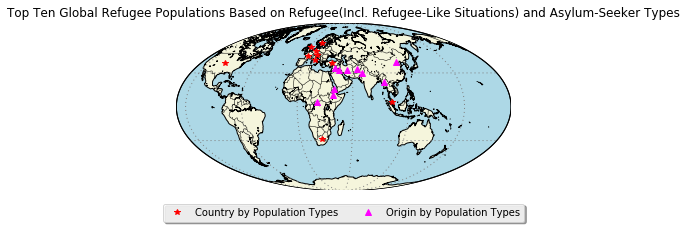

In [70]:
#####################
#PROJECTION MAPPING: Country and origin by population types 
#####################

#Create lists of lats/lons for country 
top_10_country_poptype_latslons = top_10_country_poptype_map(country_poptype_list, poptype_latslons_dict)

clat,clon = [],[]

for row in top_10_country_poptype_latslons: 
  # print(row)
  clat.append(row[0])
  clon.append(row[1])
# print(clat,clon)

#Create lists of lats/lons for origin
top_10_origin_poptype_latslons = top_10_origin_poptype_map(origin_poptype_list, poptype_latslons_dict)

olat,olon = [],[]

for row in top_10_origin_poptype_latslons: 
  # print(row)
  olat.append(row[0])
  olon.append(row[1])
# print(olat,olon)

# #defining the map 
poptype_map = Basemap(projection='moll', resolution = 'c', area_thresh=500.0,
    lat_0=0, lon_0=50)

#drawing coastlines and country boundaries 
poptype_map.drawcoastlines()
poptype_map.drawcountries()
poptype_map.fillcontinents(color='beige', lake_color='lightblue')
poptype_map.drawmapboundary(fill_color='lightblue')

#defining lats and lons lines: begin, end, apart from np.arrange() 
poptype_map.drawmeridians(np.arange(0, 420, 60),color='gray', dashes=[1,3])
poptype_map.drawparallels(np.arange(-90, 120, 60),color='gray', dashes=[1,3])

# create plot axes for country and origin
x,y = poptype_map(clon,clat)
a,b = poptype_map(olon,olat)

linexy,=poptype_map.plot(x, y, '*', color='red', markersize=6,label='Country by Population Types')
lineab,=poptype_map.plot(a, b, 'g^', color='magenta', markersize=6,label='Origin by Population Types')

plt.legend(loc='upper center', bbox_to_anchor=(0.5,-0.05),ncol=5,fancybox=True,shadow=True)
plt.title('Top Ten Global Refugee Populations Based on Refugee(Incl. Refugee-Like Situations) and Asylum-Seeker Types' )

plt.show()